In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
data = pd.read_csv('for_analysis.csv')
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,Publisher,Supported Languages,Popular Tags,Game Features,Processor,Memory,Graphics_Series,Storage_Clean,Is_Upcoming,description_length
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,larian studios,"['english', 'french', 'german', 'spanish - spa...","['rpg', 'choices matter', 'character customiza...","['single-player', 'online co-op', 'lan co-op',...",Intel i5,8.0,gtx 970,150.0,0,207
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",valve,"['english', 'czech', 'danish', 'dutch', 'finni...","['fps', 'shooter', 'multiplayer', 'competitive...","['steam achievements', 'full controller suppor...",Intel Core2 Duo,2.0,256 mb,15.0,0,275
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,electronic arts,"['english', 'french', 'italian', 'german', 'sp...","['free to play', 'multiplayer', 'battle royale...","['online pvp', 'online co-op', 'steam achievem...",AMD FX,6.0,gt 640,56.0,0,284
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,xbox game studios,"['english', 'french', 'italian', 'german', 'sp...","['racing', 'open world', 'driving', 'multiplay...","['single-player', 'online pvp', 'online co-op'...",Intel i5,8.0,gtx 970,110.0,0,288
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",activision,"['english', 'french', 'italian', 'german', 'sp...","['fps', 'multiplayer', 'shooter', 'action', 's...","['single-player', 'online pvp', 'online co-op'...",Intel i5,8.0,gtx 960,125.0,0,124
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,vector3 studio,"['english', 'simplified chinese', 'french', 'g...","['early access', 'open world survival craft', ...","['single-player', 'online co-op', 'lan co-op',...",Unknown,5.0,Unknown,1.0,1,211
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,samar studio,"['english', 'french', 'german', 'russian', 'ja...","['early access', 'survival', 'building', 'sand...","['single-player', 'mmo', 'online pvp', 'lan pv...",Unknown,4.0,Unknown,1.0,1,245
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,cathedral studios,"['english', 'french', 'italian', 'german', 'sp...","['early access', 'horror', 'fps', 'shooter', '...","['single-player', 'online pvp', 'online co-op'...",Unknown,5.0,Unknown,1.0,1,232
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,kagura games,"['english', 'japanese', 'simplified chinese']","['casual', 'rpg', 'simulation', 'sexual conten...",['single-player'],Unknown,3.0,Unknown,1.0,1,197


## Extract Features

Extract keywords from the description for each game

In [3]:
import gensim
from gensim import corpora
from nltk.corpus import stopwords
import string
import nltk
nltk.download('stopwords')


stop = set(stopwords.words('english'))
exclude = set(string.punctuation)


def clean(doc):
    tokens = gensim.utils.simple_preprocess(doc, deacc=True, min_len=3)
    stop_free = " ".join([i for i in tokens if i not in stop])
    punc_free = ''.join(ch for ch in stop_free if ch not in exclude)
    return punc_free.split()

data['cleaned_description'] = data['Game Description'].fillna('').apply(clean)

dictionary = corpora.Dictionary(data['cleaned_description'])
corpus = [dictionary.doc2bow(text) for text in data['cleaned_description']]

ldamodel = gensim.models.LdaModel(corpus, num_topics=5, id2word = dictionary, passes=20)

def get_dominant_topic(ldamodel, corpus, texts):

    dominant_topic = []
    
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        
        dominant_topic.append(int(row[0][0]))
        
    return dominant_topic

data['Topics_from_description'] = get_dominant_topic(ldamodel, corpus, data['cleaned_description'])


def get_dominant_topic_keywords(ldamodel, corpus, num_keywords=5):
    dominant_topic_keywords = []
    
    for i, row_list in enumerate(ldamodel[corpus]):
        row = row_list[0] if ldamodel.per_word_topics else row_list            
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        
        topic_num = int(row[0][0])
        topic_words = [word for word, prob in ldamodel.show_topic(topic_num, topn=num_keywords)]
        
        dominant_topic_keywords.append(", ".join(topic_words))
        
    return dominant_topic_keywords

data['Topics_from_description'] = get_dominant_topic_keywords(ldamodel, corpus)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\user\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


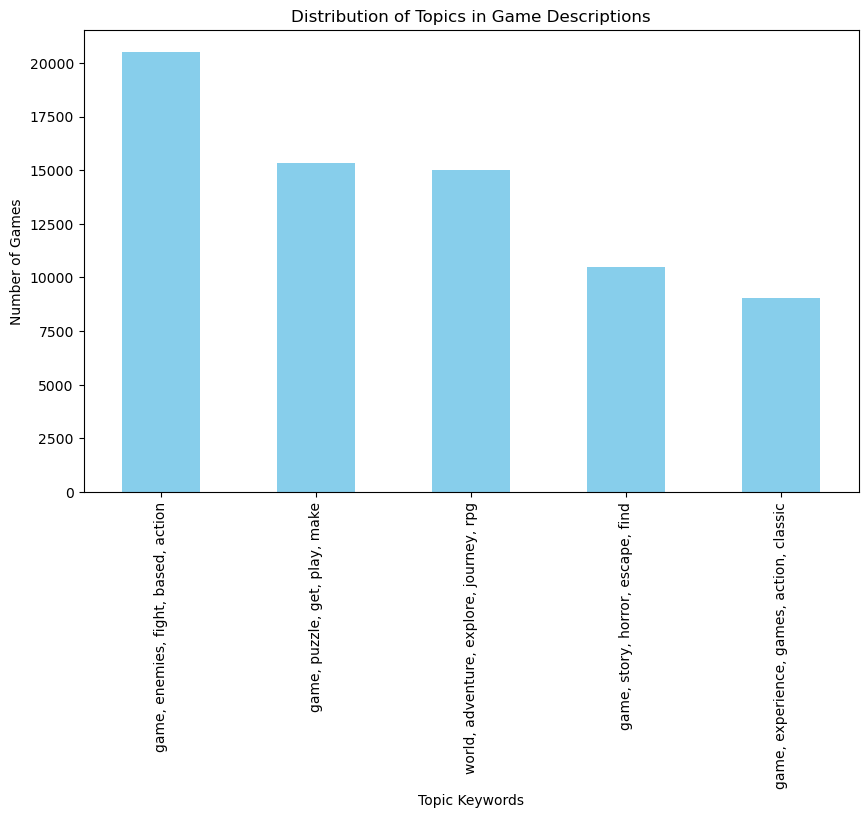

In [4]:
import matplotlib.pyplot as plt

topics = data['Topics_from_description'].value_counts()

plt.figure(figsize=(10,6))
topics.plot(kind='bar', color='skyblue')
plt.title('Distribution of Topics in Game Descriptions')
plt.xlabel('Topic Keywords')
plt.ylabel('Number of Games')
plt.show()

In [5]:
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,...,Popular Tags,Game Features,Processor,Memory,Graphics_Series,Storage_Clean,Is_Upcoming,description_length,cleaned_description,Topics_from_description
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,...,"['rpg', 'choices matter', 'character customiza...","['single-player', 'online co-op', 'lan co-op',...",Intel i5,8.0,gtx 970,150.0,0,207,"[baldur, gate, story, rich, party, based, rpg,...","world, adventure, explore, journey, rpg"
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",...,"['fps', 'shooter', 'multiplayer', 'competitive...","['steam achievements', 'full controller suppor...",Intel Core2 Duo,2.0,256 mb,15.0,0,275,"[counter, strike, global, offensive, expands, ...","game, experience, games, action, classic"
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,...,"['free to play', 'multiplayer', 'battle royale...","['online pvp', 'online co-op', 'steam achievem...",AMD FX,6.0,gt 640,56.0,0,284,"[apex, legends, award, winning, free, play, he...","game, enemies, fight, based, action"
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,...,"['racing', 'open world', 'driving', 'multiplay...","['single-player', 'online pvp', 'online co-op'...",Intel i5,8.0,gtx 970,110.0,0,288,"[ultimate, horizon, adventure, awaits, explore...","game, experience, games, action, classic"
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",...,"['fps', 'multiplayer', 'shooter', 'action', 's...","['single-player', 'online pvp', 'online co-op'...",Intel i5,8.0,gtx 960,125.0,0,124,"[welcome, call, duty, home, call, duty, modern...","game, experience, games, action, classic"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,...,"['early access', 'open world survival craft', ...","['single-player', 'online co-op', 'lan co-op',...",Unknown,5.0,Unknown,1.0,1,211,"[get, ready, waterworld, themed, survival, gam...","game, enemies, fight, based, action"
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,...,"['early access', 'survival', 'building', 'sand...","['single-player', 'mmo', 'online pvp', 'lan pv...",Unknown,4.0,Unknown,1.0,1,245,"[front, survival, open, world, crafting, soc, ...","game, experience, games, action, classic"
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,...,"['early access', 'horror', 'fps', 'shooter', '...","['single-player', 'online pvp', 'online co-op'...",Unknown,5.0,Unknown,1.0,1,232,"[welcome, bornless, action, horror, fps, face,...","game, enemies, fight, based, action"
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,...,"['casual', 'rpg', 'simulation', 'sexual conten...",['single-player'],Unknown,3.0,Unknown,1.0,1,197,"[unforgettable, summer, memories, made, half, ...","world, adventure, explore, journey, rpg"


In [6]:
data['Popular Tags'].unique()

array(["['rpg', 'choices matter', 'character customization', 'story rich', 'adventure', 'online co-op', 'crpg', 'multiplayer', 'fantasy', 'turn-based combat', 'dungeons & dragons', 'co-op campaign', 'strategy', 'singleplayer', 'romance', 'class-based', 'dark fantasy', 'combat', 'controller', 'stealth']",
       "['fps', 'shooter', 'multiplayer', 'competitive', 'action', 'team-based', 'esports', 'tactical', 'first-person', 'pvp', 'online co-op', 'co-op', 'strategy', 'military', 'war', 'difficult', 'trading', 'realistic', 'fast-paced', 'moddable']",
       "['free to play', 'multiplayer', 'battle royale', 'shooter', 'fps', 'first-person', 'pvp', 'action', 'team-based', 'hero shooter', 'tactical', 'sci-fi', 'survival', 'character customization', 'loot', 'funny', 'co-op', 'lore-rich', 'cyberpunk', 'horror']",
       ...,
       "['early access', 'horror', 'fps', 'shooter', 'multiplayer', 'action', 'adventure', 'survival horror', 'demons', 'atmospheric', 'action-adventure', 'first-person', 

## Feature Engineering

### Map each summary category corresponding number

In [7]:
review_mapping = {
    'Overwhelmingly Positive': 9,
    'Very Positive': 8,
    'Positive': 7,
    'Mostly Positive': 6,
    'Mixed': 5,
    'Mostly Negative': 4,
    'Negative': 3,
    'Very Negative': 2,
    'Overwhelmingly Negative': 1,
    'Unknown': 0
}

data['Reviews_Summary_Numeric'] = data['Reviews Summary'].map(review_mapping)
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,...,Game Features,Processor,Memory,Graphics_Series,Storage_Clean,Is_Upcoming,description_length,cleaned_description,Topics_from_description,Reviews_Summary_Numeric
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,...,"['single-player', 'online co-op', 'lan co-op',...",Intel i5,8.0,gtx 970,150.0,0,207,"[baldur, gate, story, rich, party, based, rpg,...","world, adventure, explore, journey, rpg",9
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",...,"['steam achievements', 'full controller suppor...",Intel Core2 Duo,2.0,256 mb,15.0,0,275,"[counter, strike, global, offensive, expands, ...","game, experience, games, action, classic",8
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,...,"['online pvp', 'online co-op', 'steam achievem...",AMD FX,6.0,gt 640,56.0,0,284,"[apex, legends, award, winning, free, play, he...","game, enemies, fight, based, action",5
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,...,"['single-player', 'online pvp', 'online co-op'...",Intel i5,8.0,gtx 970,110.0,0,288,"[ultimate, horizon, adventure, awaits, explore...","game, experience, games, action, classic",8
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",...,"['single-player', 'online pvp', 'online co-op'...",Intel i5,8.0,gtx 960,125.0,0,124,"[welcome, call, duty, home, call, duty, modern...","game, experience, games, action, classic",5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,...,"['single-player', 'online co-op', 'lan co-op',...",Unknown,5.0,Unknown,1.0,1,211,"[get, ready, waterworld, themed, survival, gam...","game, enemies, fight, based, action",0
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,...,"['single-player', 'mmo', 'online pvp', 'lan pv...",Unknown,4.0,Unknown,1.0,1,245,"[front, survival, open, world, crafting, soc, ...","game, experience, games, action, classic",0
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,...,"['single-player', 'online pvp', 'online co-op'...",Unknown,5.0,Unknown,1.0,1,232,"[welcome, bornless, action, horror, fps, face,...","game, enemies, fight, based, action",0
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,...,['single-player'],Unknown,3.0,Unknown,1.0,1,197,"[unforgettable, summer, memories, made, half, ...","world, adventure, explore, journey, rpg",0


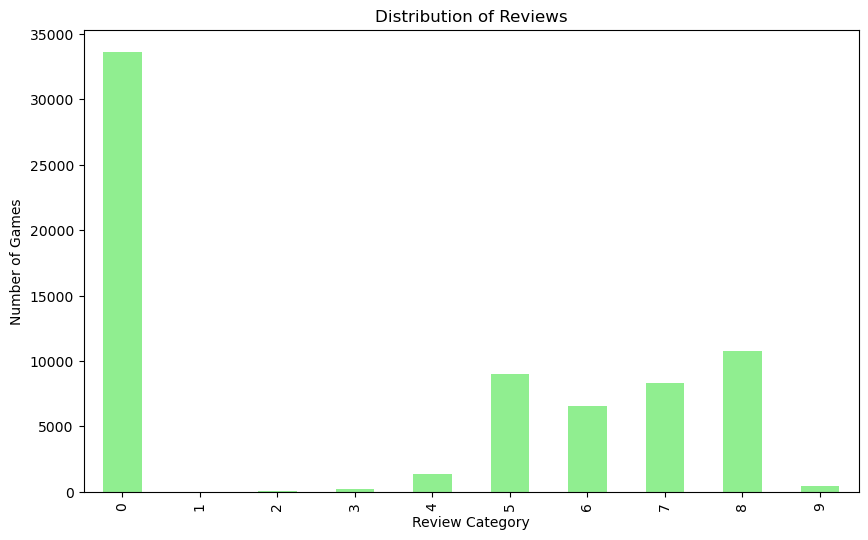

In [8]:
plt.figure(figsize=(10,6))
data['Reviews_Summary_Numeric'].value_counts().sort_index().plot(kind='bar', color='lightgreen')
plt.title('Distribution of Reviews')
plt.xlabel('Review Category')
plt.ylabel('Number of Games')
plt.show()

### As we have seen before the columns Processor and Graphics_Series have a lot of unique values. We can create new column which will represent the textual value in the form of vectors. 

In [9]:
import numpy as np
import pandas as pd
import re
from gensim.models import Word2Vec

def split_number_unit(s):
    if pd.isna(s):
        return s
    return re.sub(r'(\d+)([a-zA-Z]+)', r'\1 \2', s)

data['Graphics_Series_clean'] = data['Graphics_Series'].str.replace('[^a-zA-Z0-9 ]', '').str.lower()
data['Graphics_Series_clean'] = data['Graphics_Series_clean'].apply(split_number_unit)
data['Graphics_Series_clean'] = data['Graphics_Series_clean'].apply(lambda x: ' '.join([word for word in str(x).split() if word not in ['intel', 'api']]))
data['Graphics_Series_split'] = data['Graphics_Series_clean'].str.split()

def reorder_list(my_list):
    if not my_list:
        return my_list
    if my_list[0].isnumeric():
        return my_list[::-1]
    return my_list

data['Graphics_Series_reordered'] = data['Graphics_Series_split'].apply(reorder_list)

model = Word2Vec(sentences=data['Graphics_Series_reordered'].dropna().tolist(), vector_size=50, window=5, min_count=1, sg=0)

def sentence_to_vec(my_list, model):
    if my_list is None or len(my_list) != 2:
        return [np.nan] * 100   

    vectors = [model.wv[word] for word in my_list if word in model.wv.index_to_key]
    
    if len(vectors) != 2:
        return [np.nan] * 100

    combined_vector = np.concatenate(vectors)  
    return combined_vector.tolist()

data['Graphics_Series_vector'] = data['Graphics_Series_reordered'].apply(lambda x: sentence_to_vec(x, model))

columns = [f'Graphics_vendor_dim_{i}' for i in range(50)] + [f'Graphics_model_dim_{i}' for i in range(50)]
vector_df = pd.DataFrame(data['Graphics_Series_vector'].tolist(), columns=columns, index=data.index)
data = pd.concat([data, vector_df], axis=1)

C:\Users\user\AppData\Local\Temp\ipykernel_18196\4021289514.py:11: FutureWarning: The default value of regex will change from True to False in a future version.
  data['Graphics_Series_clean'] = data['Graphics_Series'].str.replace('[^a-zA-Z0-9 ]', '').str.lower()


In [10]:
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,...,Graphics_model_dim_40,Graphics_model_dim_41,Graphics_model_dim_42,Graphics_model_dim_43,Graphics_model_dim_44,Graphics_model_dim_45,Graphics_model_dim_46,Graphics_model_dim_47,Graphics_model_dim_48,Graphics_model_dim_49
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,...,0.125871,0.225271,0.241383,0.186481,0.288552,0.324265,0.178344,-0.252043,-0.177467,0.323279
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",...,0.312369,-0.882538,-0.086228,-0.155846,0.750685,0.374807,-0.205107,-0.519462,-0.583593,-0.409190
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,...,0.164048,-0.014693,0.173174,0.086304,0.428120,0.272555,-0.152293,-0.274858,-0.325653,0.138640
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,...,0.125871,0.225271,0.241383,0.186481,0.288552,0.324265,0.178344,-0.252043,-0.177467,0.323279
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",...,0.129637,0.183546,0.195395,0.174153,0.292096,0.282643,0.075989,-0.203469,-0.164882,0.283314
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Now we have new columns which can describe graphic card information. However, we have too many columns. We can use PCA to reduc dimensionality but keep the information. Before doing so we should do nomralization.

In [11]:
from sklearn.preprocessing import StandardScaler

vendor_cols = [f'Graphics_vendor_dim_{i}' for i in range(50)]
model_cols = [f'Graphics_model_dim_{i}' for i in range(50)]
combined_data = data[vendor_cols + model_cols]

scaler = StandardScaler()
scaled_data = scaler.fit_transform(combined_data.fillna(0))

from sklearn.decomposition import PCA

pca = PCA(n_components=20)  
reduced_data = pca.fit_transform(scaled_data)

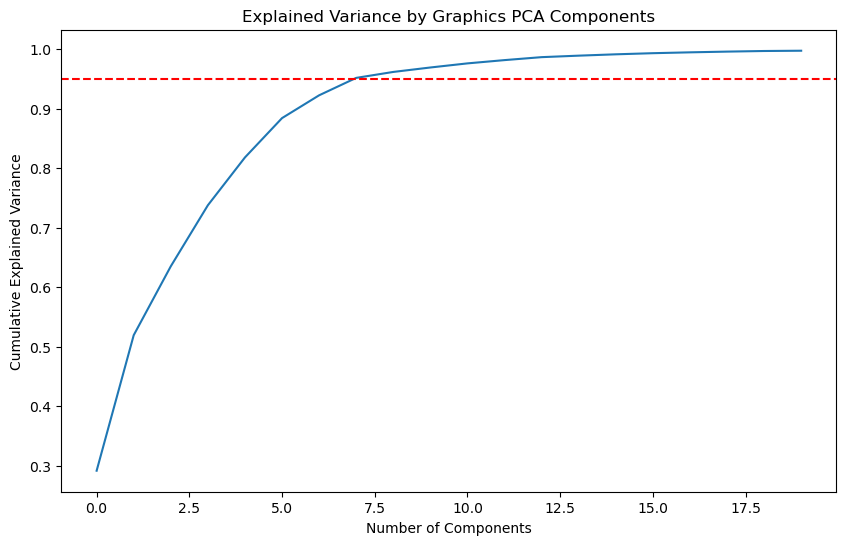

In [12]:
plt.figure(figsize=(10,6))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.title('Explained Variance by Graphics PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.axhline(y=0.95, color='r', linestyle='--') 
plt.show()

In [13]:
data.drop(columns=vendor_cols + model_cols, inplace=True)

for i in range(20):
    data[f'Graphics_PCA_dim_{i}'] = reduced_data[:, i]

In [14]:
data.shape

(70337, 47)

In [15]:
for i in data.columns:
    print(i)

Title
Original Price
Discounted Price
Price Difference
Release Date
Game Description
Reviews Summary
Reviews_number
Reviews_percentage
Developer
Publisher
Supported Languages
Popular Tags
Game Features
Processor
Memory
Graphics_Series
Storage_Clean
Is_Upcoming
description_length
cleaned_description
Topics_from_description
Reviews_Summary_Numeric
Graphics_Series_clean
Graphics_Series_split
Graphics_Series_reordered
Graphics_Series_vector
Graphics_PCA_dim_0
Graphics_PCA_dim_1
Graphics_PCA_dim_2
Graphics_PCA_dim_3
Graphics_PCA_dim_4
Graphics_PCA_dim_5
Graphics_PCA_dim_6
Graphics_PCA_dim_7
Graphics_PCA_dim_8
Graphics_PCA_dim_9
Graphics_PCA_dim_10
Graphics_PCA_dim_11
Graphics_PCA_dim_12
Graphics_PCA_dim_13
Graphics_PCA_dim_14
Graphics_PCA_dim_15
Graphics_PCA_dim_16
Graphics_PCA_dim_17
Graphics_PCA_dim_18
Graphics_PCA_dim_19


### We can now handle processor column in the similar way we handled Graphics_series. The problem would be that here we cannot make assumptions that the value inside mentioned column will necessarily show vendor and model of the processor. So we will need to give overall embedding to whole values inside Processor column.

C:\Users\user\AppData\Local\Temp\ipykernel_18196\2029800713.py:1: FutureWarning: The default value of regex will change from True to False in a future version.
  data['Processor_clean'] = data['Processor'].str.replace('[^a-zA-Z0-9 ]', '').str.lower()


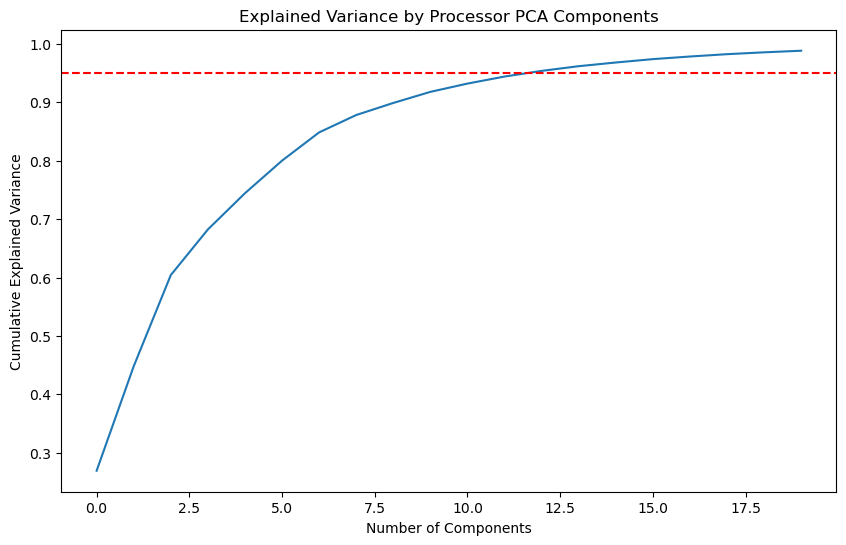

In [16]:
data['Processor_clean'] = data['Processor'].str.replace('[^a-zA-Z0-9 ]', '').str.lower()

data['Processor_split'] = data['Processor_clean'].str.split()

model_processor = Word2Vec(sentences=data['Processor_split'].dropna().tolist(), vector_size=50, window=5, min_count=1, sg=0)

def sentence_to_avg_vec(my_list, model):
    if not my_list:
        return [np.nan] * 50
    vectors = [model.wv[word] for word in my_list if word in model.wv.index_to_key]
    if not vectors:
        return [np.nan] * 50
    avg_vector = np.mean(vectors, axis=0)
    return avg_vector.tolist()

data['Processor_vector'] = data['Processor_split'].apply(lambda x: sentence_to_avg_vec(x, model_processor))

vector_df_processor = pd.DataFrame(data['Processor_vector'].tolist(), columns=[f'Processor_dim_{i}' for i in range(50)], index=data.index)
data = pd.concat([data, vector_df_processor], axis=1)

processor_cols = [f'Processor_dim_{i}' for i in range(50)]
processor_data = data[processor_cols]

scaler_processor = StandardScaler()
scaled_processor_data = scaler_processor.fit_transform(processor_data.fillna(0))

pca_processor = PCA(n_components=20)
reduced_processor_data = pca_processor.fit_transform(scaled_processor_data)

plt.figure(figsize=(10,6))
plt.plot(np.cumsum(pca_processor.explained_variance_ratio_))
plt.title('Explained Variance by Processor PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.axhline(y=0.95, color='r', linestyle='--') 
plt.show()

drop_columns = [f'Processor_dim_{i}' for i in range(50)]
data = data.drop(columns=drop_columns)

for i in range(20):
    data[f'Processor_PCA_dim_{i}'] = reduced_processor_data[:, i]

### Let us expand on developer column. When looking at developer, user is basically thinking of what type of other games they had, or most importantly whether this developer is well-Known. So we can capture relationship of Developer column with number of reviews column. We are using target encoder for this purpose

In [17]:
from sklearn.model_selection import train_test_split

train_data, test_data = train_test_split(data, test_size=0.2, random_state=42)

dev_means = train_data.explode('Developer')['Developer'].reset_index().merge(
    train_data[['Reviews_number']],
    left_on='index',
    right_index=True
).groupby('Developer')['Reviews_number'].mean().to_dict()

global_mean = train_data['Reviews_number'].mean()

def target_encode_devs(row):
    devs = str(row['Developer']).split(", ")
    return np.mean([dev_means.get(dev, global_mean) for dev in devs])

train_data['Developer_encoded'] = train_data.apply(target_encode_devs, axis=1)
test_data['Developer_encoded'] = test_data.apply(target_encode_devs, axis=1)

data['Developer_encoded'] = data['Developer'].apply(lambda x: np.mean([dev_means.get(dev, global_mean) for dev in str(x).split(", ")]))

In [18]:
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,...,Processor_PCA_dim_11,Processor_PCA_dim_12,Processor_PCA_dim_13,Processor_PCA_dim_14,Processor_PCA_dim_15,Processor_PCA_dim_16,Processor_PCA_dim_17,Processor_PCA_dim_18,Processor_PCA_dim_19,Developer_encoded
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,...,-0.009002,-0.041584,-0.042887,0.163157,0.320648,0.140835,0.225589,0.026710,-0.077963,27382.200000
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",...,0.583876,1.655196,1.465947,0.511828,-0.212972,-0.486204,-0.056104,0.525158,-0.160853,1362.466667
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,...,-0.595502,-0.674438,-1.215114,-0.067927,-0.466734,-0.613890,-0.140922,0.597513,0.149218,5490.250000
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,...,-0.009002,-0.041584,-0.042887,0.163157,0.320648,0.140835,0.225589,0.026710,-0.077963,3322.500000
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",...,-0.009002,-0.041584,-0.042887,0.163157,0.320648,0.140835,0.225589,0.026710,-0.077963,138.620265
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,...,0.038142,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,0.000000
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,...,0.038142,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,0.000000
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,...,0.038142,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,0.000000
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,...,0.038142,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,146.000000


### We can handle the Publishers in the same way

In [19]:
train_data, test_data = train_test_split(data, test_size=0.2, random_state=42)

pub_means = train_data.groupby('Publisher')['Reviews_number'].mean().to_dict()

data['Publisher_encoded_target'] = data['Publisher'].map(pub_means).fillna(0)

train_data['Publisher_encoded_target'] = train_data['Publisher'].map(pub_means).fillna(0)
test_data['Publisher_encoded_target'] = test_data['Publisher'].map(pub_means).fillna(0)

In [20]:
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,...,Processor_PCA_dim_12,Processor_PCA_dim_13,Processor_PCA_dim_14,Processor_PCA_dim_15,Processor_PCA_dim_16,Processor_PCA_dim_17,Processor_PCA_dim_18,Processor_PCA_dim_19,Developer_encoded,Publisher_encoded_target
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,...,-0.041584,-0.042887,0.163157,0.320648,0.140835,0.225589,0.026710,-0.077963,27382.200000,27382.200000
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",...,1.655196,1.465947,0.511828,-0.212972,-0.486204,-0.056104,0.525158,-0.160853,1362.466667,7480.882353
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,...,-0.674438,-1.215114,-0.067927,-0.466734,-0.613890,-0.140922,0.597513,0.149218,5490.250000,907.275862
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,...,-0.041584,-0.042887,0.163157,0.320648,0.140835,0.225589,0.026710,-0.077963,3322.500000,932.285714
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",...,-0.041584,-0.042887,0.163157,0.320648,0.140835,0.225589,0.026710,-0.077963,138.620265,322.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,...,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,0.000000,0.000000
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,...,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,0.000000,0.000000
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,...,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,0.000000,0.000000
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,...,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,146.000000,184.107843


In [21]:
for i in data.columns:
    print(i)

Title
Original Price
Discounted Price
Price Difference
Release Date
Game Description
Reviews Summary
Reviews_number
Reviews_percentage
Developer
Publisher
Supported Languages
Popular Tags
Game Features
Processor
Memory
Graphics_Series
Storage_Clean
Is_Upcoming
description_length
cleaned_description
Topics_from_description
Reviews_Summary_Numeric
Graphics_Series_clean
Graphics_Series_split
Graphics_Series_reordered
Graphics_Series_vector
Graphics_PCA_dim_0
Graphics_PCA_dim_1
Graphics_PCA_dim_2
Graphics_PCA_dim_3
Graphics_PCA_dim_4
Graphics_PCA_dim_5
Graphics_PCA_dim_6
Graphics_PCA_dim_7
Graphics_PCA_dim_8
Graphics_PCA_dim_9
Graphics_PCA_dim_10
Graphics_PCA_dim_11
Graphics_PCA_dim_12
Graphics_PCA_dim_13
Graphics_PCA_dim_14
Graphics_PCA_dim_15
Graphics_PCA_dim_16
Graphics_PCA_dim_17
Graphics_PCA_dim_18
Graphics_PCA_dim_19
Processor_clean
Processor_split
Processor_vector
Processor_PCA_dim_0
Processor_PCA_dim_1
Processor_PCA_dim_2
Processor_PCA_dim_3
Processor_PCA_dim_4
Processor_PCA_dim_5


In [22]:
data.isnull().sum()

Title                       0
Original Price              0
Discounted Price            0
Price Difference            0
Release Date                0
                           ..
Processor_PCA_dim_17        0
Processor_PCA_dim_18        0
Processor_PCA_dim_19        0
Developer_encoded           0
Publisher_encoded_target    0
Length: 72, dtype: int64

In [23]:
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,...,Processor_PCA_dim_12,Processor_PCA_dim_13,Processor_PCA_dim_14,Processor_PCA_dim_15,Processor_PCA_dim_16,Processor_PCA_dim_17,Processor_PCA_dim_18,Processor_PCA_dim_19,Developer_encoded,Publisher_encoded_target
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,...,-0.041584,-0.042887,0.163157,0.320648,0.140835,0.225589,0.026710,-0.077963,27382.200000,27382.200000
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",...,1.655196,1.465947,0.511828,-0.212972,-0.486204,-0.056104,0.525158,-0.160853,1362.466667,7480.882353
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,...,-0.674438,-1.215114,-0.067927,-0.466734,-0.613890,-0.140922,0.597513,0.149218,5490.250000,907.275862
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,...,-0.041584,-0.042887,0.163157,0.320648,0.140835,0.225589,0.026710,-0.077963,3322.500000,932.285714
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",...,-0.041584,-0.042887,0.163157,0.320648,0.140835,0.225589,0.026710,-0.077963,138.620265,322.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,...,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,0.000000,0.000000
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,...,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,0.000000,0.000000
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,...,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,0.000000,0.000000
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,...,0.015073,0.067722,0.015970,-0.054128,0.076647,-0.011680,0.027759,0.012365,146.000000,184.107843


### Handle Popular Tags

In [24]:
data['Popular Tags'].unique()

array(["['rpg', 'choices matter', 'character customization', 'story rich', 'adventure', 'online co-op', 'crpg', 'multiplayer', 'fantasy', 'turn-based combat', 'dungeons & dragons', 'co-op campaign', 'strategy', 'singleplayer', 'romance', 'class-based', 'dark fantasy', 'combat', 'controller', 'stealth']",
       "['fps', 'shooter', 'multiplayer', 'competitive', 'action', 'team-based', 'esports', 'tactical', 'first-person', 'pvp', 'online co-op', 'co-op', 'strategy', 'military', 'war', 'difficult', 'trading', 'realistic', 'fast-paced', 'moddable']",
       "['free to play', 'multiplayer', 'battle royale', 'shooter', 'fps', 'first-person', 'pvp', 'action', 'team-based', 'hero shooter', 'tactical', 'sci-fi', 'survival', 'character customization', 'loot', 'funny', 'co-op', 'lore-rich', 'cyberpunk', 'horror']",
       ...,
       "['early access', 'horror', 'fps', 'shooter', 'multiplayer', 'action', 'adventure', 'survival horror', 'demons', 'atmospheric', 'action-adventure', 'first-person', 

In [25]:
import ast

data['Popular Tags'] = data['Popular Tags'].apply(ast.literal_eval)

In [26]:
data['Popular Tags'] = data['Popular Tags'].apply(lambda x: ' '.join(x))

In [27]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(max_df=0.95, min_df=2, stop_words='english')
tfidf_matrix = vectorizer.fit_transform(data['Popular Tags'])

In [28]:
from sklearn.decomposition import TruncatedSVD

n_components = 200  
svd = TruncatedSVD(n_components=n_components)
tfidf_reduced = svd.fit_transform(tfidf_matrix)

print("Cumulative explained variance:", svd.explained_variance_ratio_.cumsum()[-1])

Cumulative explained variance: 0.8987045084319942


In [29]:
tfidf_df = pd.DataFrame(tfidf_reduced, columns=[f'tag_pc_{i}' for i in range(tfidf_reduced.shape[1])])
data = pd.concat([data, tfidf_df], axis=1)

In [30]:
data.drop(columns=['Popular Tags'], inplace=True)

In [31]:
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,...,tag_pc_190,tag_pc_191,tag_pc_192,tag_pc_193,tag_pc_194,tag_pc_195,tag_pc_196,tag_pc_197,tag_pc_198,tag_pc_199
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,...,0.020701,-0.005947,-0.002070,-0.063286,0.029510,-0.141034,0.105018,-0.022589,0.085526,0.132931
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",...,-0.000622,-0.064912,0.003124,0.029087,0.041241,-0.028827,-0.053918,-0.022789,-0.010113,-0.044906
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,...,-0.029440,0.032705,-0.102757,-0.024717,-0.039284,-0.039542,-0.014091,0.024101,-0.002093,-0.009500
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,...,0.115872,0.161033,-0.085749,-0.005286,0.050034,0.018615,0.036242,-0.030876,-0.031360,-0.007976
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",...,-0.003171,-0.017115,-0.006464,0.008253,0.017034,-0.036719,-0.025648,0.034028,-0.001216,0.029099
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,...,0.022181,-0.001417,0.015115,-0.018495,0.049410,0.000471,0.031994,0.012354,-0.063963,-0.034150
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,...,0.014889,-0.015908,0.026039,-0.018876,0.029613,-0.016249,-0.023382,0.021416,-0.009389,0.055794
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,...,0.037006,-0.017238,-0.079649,0.018388,-0.049383,0.015436,-0.011163,-0.021779,-0.017712,-0.011089
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,...,-0.019223,-0.002691,0.005530,0.000800,-0.016384,-0.011925,0.008785,0.002905,-0.015093,0.013730


Since the Popular Tags are great explanator for our purpose we are good to add 250 rows for it. 

## Handle Supported Languages

In [32]:
data['Supported Languages'].unique()

array(["['english', 'french', 'german', 'spanish - spain', 'polish', 'russian', 'simplified chinese', 'turkish', 'portuguese - brazil', 'italian', 'spanish - latin america', 'traditional chinese', 'ukrainian']",
       "['english', 'czech', 'danish', 'dutch', 'finnish', 'french', 'german', 'hungarian', 'italian', 'japanese', 'korean', 'norwegian', 'polish', 'portuguese - portugal', 'portuguese - brazil', 'romanian', 'russian', 'simplified chinese', 'spanish - spain', 'swedish', 'thai', 'traditional chinese', 'turkish', 'bulgarian', 'ukrainian', 'greek', 'spanish - latin america', 'vietnamese']",
       "['english', 'french', 'italian', 'german', 'spanish - spain', 'japanese', 'korean', 'polish', 'portuguese - brazil', 'russian', 'simplified chinese', 'traditional chinese', 'spanish - latin america', 'arabic']",
       ...,
       "['english', 'french', 'german', 'russian', 'japanese', 'simplified chinese', 'traditional chinese', 'portuguese - brazil', 'spanish - spain', 'turkish']",
  

In [33]:
def convert_to_list(entry):
    if isinstance(entry, list):
        return entry
    elif isinstance(entry, str):
        try:
            return ast.literal_eval(entry)
        except:
            return []  

data['Supported Languages'] = data['Supported Languages'].apply(convert_to_list)

In [34]:
from sklearn.feature_extraction.text import TfidfVectorizer

data['languages_str'] = data['Supported Languages'].apply(' '.join)

tfidf = TfidfVectorizer()
languages_matrix = tfidf.fit_transform(data['languages_str'])

In [35]:
from sklearn.decomposition import TruncatedSVD

n_components = 70 
svd = TruncatedSVD(n_components=n_components)
languages_svd = svd.fit_transform(languages_matrix)

print("Cumulative explained variance:", svd.explained_variance_ratio_.cumsum()[-1])

Cumulative explained variance: 0.9999232795369832


For the "Supported Languages" column, this might be reasonable to expect. The reason being that, unlike "Popular Tags" which had a multitude of different tags, the number of unique languages supported by games is limited. Therefore, even when vectorized, a significant portion of the variance might be captured by a relatively small number of components.

In [36]:
for i in range(n_components):
    data[f'language_component_{i}'] = languages_svd[:, i]

In [37]:
data = data.drop(columns=['languages_str', 'Supported Languages'])


In [38]:
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,...,language_component_60,language_component_61,language_component_62,language_component_63,language_component_64,language_component_65,language_component_66,language_component_67,language_component_68,language_component_69
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,...,0.000137,-0.000056,-0.000192,-0.000271,-0.000011,-0.000146,0.000040,-3.544916e-05,-0.000241,0.000041
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",...,-0.000038,0.000152,-0.000473,-0.000300,-0.000101,-0.000018,0.000120,-2.433236e-05,0.000011,-0.000190
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,...,0.000041,0.000074,0.000278,0.000060,-0.000089,-0.000077,0.000091,-1.680670e-04,-0.000123,-0.000073
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,...,-0.000802,0.000116,0.000056,-0.000084,-0.000050,0.000024,-0.000175,3.170374e-04,0.000089,-0.000195
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",...,0.000041,0.000074,0.000278,0.000060,-0.000089,-0.000077,0.000091,-1.680670e-04,-0.000123,-0.000073
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,...,0.000094,0.000068,0.000066,0.000079,0.000111,-0.000022,-0.000028,9.010475e-05,-0.000167,0.000032
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,...,0.000095,0.000054,0.000045,0.000111,0.000117,-0.000059,0.000023,8.582101e-05,-0.000055,0.000021
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,...,0.000203,-0.000285,0.000245,0.000340,0.000312,-0.000007,-0.000391,-4.335596e-04,0.000116,-0.000298
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,...,0.000065,0.000036,0.000008,-0.000005,-0.000030,0.000051,0.000012,-4.789475e-07,-0.000013,0.000007


## Handle Game Features

In [39]:
def convert_to_list(entry):
    if isinstance(entry, list):
        return entry
    elif isinstance(entry, str):
        try:
            return ast.literal_eval(entry)
        except:
            return []

data['Game Features'] = data['Game Features'].apply(convert_to_list)

In [40]:
from sklearn.feature_extraction.text import TfidfVectorizer

def join_list(features):
    return ' '.join(features)

data['Game Features Str'] = data['Game Features'].apply(join_list)

vectorizer = TfidfVectorizer(max_df=0.95, max_features=5000, stop_words='english')
X = vectorizer.fit_transform(data['Game Features Str'])

In [41]:
from sklearn.decomposition import TruncatedSVD

n_components = 50
svd = TruncatedSVD(n_components=n_components)
X_reduced = svd.fit_transform(X)

print(f'Cumulative explained variance: {svd.explained_variance_ratio_.sum()}')

Cumulative explained variance: 0.9999999999999805


In [42]:
for i in range(n_components):
    data[f'Game_Features_Component_{i}'] = X_reduced[:, i]


C:\Users\user\AppData\Local\Temp\ipykernel_18196\2874947741.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  data[f'Game_Features_Component_{i}'] = X_reduced[:, i]
C:\Users\user\AppData\Local\Temp\ipykernel_18196\2874947741.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  data[f'Game_Features_Component_{i}'] = X_reduced[:, i]
C:\Users\user\AppData\Local\Temp\ipykernel_18196\2874947741.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor p

In [43]:
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Game Description,Reviews Summary,Reviews_number,Reviews_percentage,Developer,...,Game_Features_Component_40,Game_Features_Component_41,Game_Features_Component_42,Game_Features_Component_43,Game_Features_Component_44,Game_Features_Component_45,Game_Features_Component_46,Game_Features_Component_47,Game_Features_Component_48,Game_Features_Component_49
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,"Baldur’s Gate 3 is a story-rich, party-based R...",Overwhelmingly Positive,128900.0,96.0,larian studios,...,-3.752068e-17,-5.626503e-17,-8.296976e-18,-8.283666e-17,4.428295e-17,5.904398e-17,3.487476e-17,-7.840903e-17,6.841965e-17,-3.879627e-17
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,Counter-Strike: Global Offensive (CS: GO) expa...,Very Positive,75284.0,89.0,"valve, hidden path entertainment",...,-5.377643e-17,-1.249687e-16,-2.429158e-17,1.749325e-16,1.399634e-16,1.733351e-16,-5.724587e-17,1.887602e-17,1.127570e-16,-2.479968e-16
2,Apex Legends™,0.00,0.00,0.00,2020.0,"Apex Legends is the award-winning, free-to-pla...",Mixed,18581.0,65.0,respawn entertainment,...,1.056502e-16,-4.436433e-17,-9.495938e-17,-7.534690e-17,4.976154e-18,-1.164262e-16,-7.986501e-17,-5.595132e-17,-9.005033e-17,-1.273261e-16
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,Your Ultimate Horizon Adventure awaits! Explor...,Very Positive,4120.0,87.0,playground games,...,-2.900918e-17,-2.390910e-17,-8.518384e-17,-7.625370e-17,1.479306e-17,-4.062065e-17,1.344693e-17,-4.666351e-17,-1.209758e-16,-7.212427e-17
4,Call of Duty®,0.00,0.00,0.00,2022.0,"Welcome to Call of Duty® HQ, the home of Call ...",Mixed,8257.0,49.0,"infinity ward, raven software, beenox, treyarc...",...,1.264952e-16,-7.266560e-17,-1.129759e-16,-1.272955e-16,5.849241e-18,-1.603018e-16,-7.009542e-17,-2.853345e-17,-1.332468e-16,-1.219595e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,Get ready for a Waterworld-themed survival gam...,Unknown,0.0,0.0,vector3 studio,...,-5.073546e-18,-8.413242e-17,-1.388014e-17,-9.187902e-17,1.295204e-17,4.460908e-17,-3.156064e-18,-6.736623e-17,5.652493e-17,-5.112368e-17
70333,The Front,0.00,0.00,0.00,2024.0,The Front is a survival-open-world-crafting (S...,Unknown,0.0,0.0,samar studio,...,5.131833e-17,-3.470993e-17,-5.916168e-17,-1.164985e-16,-4.222663e-17,5.577881e-17,-1.149459e-16,-4.262811e-17,-4.367225e-17,-1.253272e-16
70334,The Bornless,0.00,0.00,0.00,2024.0,"Welcome to The Bornless, an action horror FPS....",Unknown,0.0,0.0,cathedral studios,...,7.744485e-17,-4.626410e-17,-7.369554e-17,-9.065256e-17,6.893734e-18,-3.762068e-18,-1.186273e-16,6.151133e-18,-2.173112e-17,-8.319965e-17
70335,Winter Memories,0.00,0.00,0.00,2024.0,After the unforgettable summer memories you’ve...,Unknown,0.0,0.0,dojin otome,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00


We have increased the data dimensionality quite a bit but we gained useful information. It might be consern to be overfitting, but we included every game on the platfrom.

## Now, having expanded our data and extracting useful information from our features, we can eliminate columns which we have already described in other columns

In [44]:
columns_to_remove = ['Game Description', 'Reviews Summary', 'Developer', 'Publisher', 
                     'Game Features', 'Processor', 'Graphics_Series', 'cleaned_description', 
                     'Topics_from_description', 'Graphics_Series_clean', 'Graphics_Series_split', 
                     'Graphics_Series_reordered', 'Graphics_Series_vector', 'Processor_clean', 
                     'Processor_split', 'Processor_vector', 'Game Features Str']

data = data.drop(columns=columns_to_remove)

In [45]:
for i in data.columns:
    print(i)

Title
Original Price
Discounted Price
Price Difference
Release Date
Reviews_number
Reviews_percentage
Memory
Storage_Clean
Is_Upcoming
description_length
Reviews_Summary_Numeric
Graphics_PCA_dim_0
Graphics_PCA_dim_1
Graphics_PCA_dim_2
Graphics_PCA_dim_3
Graphics_PCA_dim_4
Graphics_PCA_dim_5
Graphics_PCA_dim_6
Graphics_PCA_dim_7
Graphics_PCA_dim_8
Graphics_PCA_dim_9
Graphics_PCA_dim_10
Graphics_PCA_dim_11
Graphics_PCA_dim_12
Graphics_PCA_dim_13
Graphics_PCA_dim_14
Graphics_PCA_dim_15
Graphics_PCA_dim_16
Graphics_PCA_dim_17
Graphics_PCA_dim_18
Graphics_PCA_dim_19
Processor_PCA_dim_0
Processor_PCA_dim_1
Processor_PCA_dim_2
Processor_PCA_dim_3
Processor_PCA_dim_4
Processor_PCA_dim_5
Processor_PCA_dim_6
Processor_PCA_dim_7
Processor_PCA_dim_8
Processor_PCA_dim_9
Processor_PCA_dim_10
Processor_PCA_dim_11
Processor_PCA_dim_12
Processor_PCA_dim_13
Processor_PCA_dim_14
Processor_PCA_dim_15
Processor_PCA_dim_16
Processor_PCA_dim_17
Processor_PCA_dim_18
Processor_PCA_dim_19
Developer_encoded
Publ

In [46]:
nan_columns = data.columns[data.isnull().any()].tolist()
nan_count = data[nan_columns].isnull().sum()

print(nan_count)

Series([], dtype: float64)


In [47]:
data

,Title,Original Price,Discounted Price,Price Difference,Release Date,Reviews_number,Reviews_percentage,Memory,Storage_Clean,Is_Upcoming,...,Game_Features_Component_40,Game_Features_Component_41,Game_Features_Component_42,Game_Features_Component_43,Game_Features_Component_44,Game_Features_Component_45,Game_Features_Component_46,Game_Features_Component_47,Game_Features_Component_48,Game_Features_Component_49
0,Baldur's Gate 3,29.99,29.99,0.00,2023.0,128900.0,96.0,8.0,150.0,0,...,-3.752068e-17,-5.626503e-17,-8.296976e-18,-8.283666e-17,4.428295e-17,5.904398e-17,3.487476e-17,-7.840903e-17,6.841965e-17,-3.879627e-17
1,Counter-Strike: Global Offensive,14.99,14.99,0.00,2012.0,75284.0,89.0,2.0,15.0,0,...,-5.377643e-17,-1.249687e-16,-2.429158e-17,1.749325e-16,1.399634e-16,1.733351e-16,-5.724587e-17,1.887602e-17,1.127570e-16,-2.479968e-16
2,Apex Legends™,0.00,0.00,0.00,2020.0,18581.0,65.0,6.0,56.0,0,...,1.056502e-16,-4.436433e-17,-9.495938e-17,-7.534690e-17,4.976154e-18,-1.164262e-16,-7.986501e-17,-5.595132e-17,-9.005033e-17,-1.273261e-16
3,Forza Horizon 5,34.78,17.39,17.39,2021.0,4120.0,87.0,8.0,110.0,0,...,-2.900918e-17,-2.390910e-17,-8.518384e-17,-7.625370e-17,1.479306e-17,-4.062065e-17,1.344693e-17,-4.666351e-17,-1.209758e-16,-7.212427e-17
4,Call of Duty®,0.00,0.00,0.00,2022.0,8257.0,49.0,8.0,125.0,0,...,1.264952e-16,-7.266560e-17,-1.129759e-16,-1.272955e-16,5.849241e-18,-1.603018e-16,-7.009542e-17,-2.853345e-17,-1.332468e-16,-1.219595e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,Sunkenland,0.00,0.00,0.00,2024.0,0.0,0.0,5.0,1.0,1,...,-5.073546e-18,-8.413242e-17,-1.388014e-17,-9.187902e-17,1.295204e-17,4.460908e-17,-3.156064e-18,-6.736623e-17,5.652493e-17,-5.112368e-17
70333,The Front,0.00,0.00,0.00,2024.0,0.0,0.0,4.0,1.0,1,...,5.131833e-17,-3.470993e-17,-5.916168e-17,-1.164985e-16,-4.222663e-17,5.577881e-17,-1.149459e-16,-4.262811e-17,-4.367225e-17,-1.253272e-16
70334,The Bornless,0.00,0.00,0.00,2024.0,0.0,0.0,5.0,1.0,1,...,7.744485e-17,-4.626410e-17,-7.369554e-17,-9.065256e-17,6.893734e-18,-3.762068e-18,-1.186273e-16,6.151133e-18,-2.173112e-17,-8.319965e-17
70335,Winter Memories,0.00,0.00,0.00,2024.0,0.0,0.0,3.0,1.0,1,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00


## Having data ready for crafting the system let us proceed

In [48]:
from sklearn.preprocessing import StandardScaler

original_data = data.copy()

titles = data['Title']
numerical_data = data.drop('Title', axis=1)

scaler = StandardScaler()
scaled_data = scaler.fit_transform(numerical_data)

scaled_data_df = pd.DataFrame(scaled_data, columns=numerical_data.columns, index=data.index)
scaled_data_df['Title'] = titles

data = scaled_data_df

### Let's run test code for the sample of whole data
Running it on whole data overloaded memory, so we will need to change approach. First we will test how it works for sample of data. Then we will run it on whole data chunk bu chunk and save the recommended games for each row in new file. 

In [49]:
from sklearn.metrics.pairwise import cosine_similarity

sample_data = data.sample(1000, random_state=42)

cosine_sim_sample_data = sample_data.drop('Title', axis=1)

num_sample_games = cosine_sim_sample_data.shape[0]
similarity_matrix_sample = pd.DataFrame(np.zeros((num_sample_games, num_sample_games)), columns=sample_data['Title'], index=sample_data['Title'])

for i, (idx, row) in enumerate(cosine_sim_sample_data.iterrows()):
    sim_scores = cosine_similarity([row], cosine_sim_sample_data)
    similarity_matrix_sample.iloc[i] = sim_scores[0]

def get_recommendations_sample(title, similarity_matrix=similarity_matrix_sample):
    idx = sample_data.index[sample_data['Title'] == title].tolist()[0]
    sim_scores = list(enumerate(similarity_matrix.loc[title]))
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)
    sim_scores = sim_scores[1:11]
    game_indices = [i[0] for i in sim_scores]
    return sample_data['Title'].iloc[game_indices]

In [50]:
sample_data

,Original Price,Discounted Price,Price Difference,Release Date,Reviews_number,Reviews_percentage,Memory,Storage_Clean,Is_Upcoming,description_length,...,Game_Features_Component_41,Game_Features_Component_42,Game_Features_Component_43,Game_Features_Component_44,Game_Features_Component_45,Game_Features_Component_46,Game_Features_Component_47,Game_Features_Component_48,Game_Features_Component_49,Title
67791,-0.072097,-0.070881,-0.040955,0.602584,-0.081238,-0.989349,0.193168,-0.062088,-0.410541,0.182881,...,-1.911563,0.480138,-0.128184,-0.237367,0.170234,-0.876061,-1.295449,1.333112,-0.498905,iO Inner Self - The Lava Planet VR
18766,-0.043354,-0.017372,-0.040955,0.602584,-0.069452,0.988083,0.193168,0.009334,-0.410541,1.323942,...,0.276165,0.169370,0.486659,0.674423,-0.103959,0.410047,0.289289,-0.148828,0.225453,Project Dagger
48576,-0.096735,-0.116745,-0.040955,-0.360965,-0.081238,-0.989349,-0.716109,-0.065064,-0.410541,0.812432,...,-0.084272,0.893488,-0.850473,-1.308494,-0.849339,0.410047,-1.146716,-0.148828,0.619278,The Antidote
16446,-0.043354,-0.017372,-0.040955,-1.966879,0.192180,0.617315,-0.716109,-0.050184,-0.410541,1.625602,...,0.276165,0.169370,0.486659,0.674423,-0.103959,0.410047,0.289289,-0.148828,0.225453,International Snooker
14097,0.100366,0.250173,-0.040955,-0.039782,-0.027811,1.136390,0.193168,-0.020425,-0.410541,1.376405,...,-0.301875,0.131976,-2.211086,1.141537,-2.464664,-0.768886,-3.422317,2.222275,-1.316037,2MD: VR Football Evolution
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24948,-0.072097,-0.070881,-0.040955,0.281401,0.010687,0.889211,0.193168,-0.065064,-0.410541,-0.722098,...,0.658657,1.460678,-0.946968,-1.949269,-1.932057,0.410047,-1.070139,0.120799,0.993650,Celerity
58730,-0.207194,-0.322373,-0.040955,1.244949,-0.081238,-0.989349,0.193168,-0.050184,2.435810,0.458310,...,-1.911563,0.480138,-0.128184,-0.237367,0.170234,-0.876061,-1.295449,1.333112,-0.498905,Forced Termination
12409,0.223554,0.078180,0.218558,0.602584,-0.069452,1.309416,1.405538,0.009334,-0.410541,-0.931948,...,0.032418,-0.184456,-0.909455,-0.848888,0.488751,-0.983237,-0.329649,1.234316,-0.087708,Strawhart
57757,-0.072097,-0.070881,-0.040955,-0.682148,-0.081238,-0.989349,0.193168,-0.020425,-0.410541,0.104188,...,-1.911563,0.480138,-0.128184,-0.237367,0.170234,-0.876061,-1.295449,1.333112,-0.498905,Snowglobe


In [51]:
game_title = sample_data['Title'].iloc[998]  
recommended_games = get_recommendations_sample(game_title)
recommended_games

57203                  Binary Trigger
22803                   AstroBlast VR
51425                         TOYTANK
32168    三国虎将传VR2-Sanguo Warriors VR2
52063            D.F.R.: The Light VR
57482                           Jingo
15806                     Lucid Trips
55151          Alone In The Forest VR
24876                         Inbound
21841                       Toy Clash
Name: Title, dtype: object

## THE NEXT cell gave memory error so we proceeded with different approach

In [52]:
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd
import numpy as np

cosine_sim_data = data.drop('Title', axis=1)

num_games = cosine_sim_data.shape[0]
similarity_matrix = pd.DataFrame(np.zeros((num_games, num_games)), columns=data['Title'], index=data['Title'])

for i, (idx, row) in enumerate(cosine_sim_data.iterrows()):
    sim_scores = cosine_similarity([row], cosine_sim_data)
    similarity_matrix.iloc[i] = sim_scores[0]

recommendations_df = pd.DataFrame(columns=['Title', 'Recommendations'])

for title in data['Title']:
    sim_scores = list(enumerate(similarity_matrix.loc[title]))
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)
    sim_scores = sim_scores[1:11]  
    game_indices = [i[0] for i in sim_scores]
    recommendations = data['Title'].iloc[game_indices].tolist()
    recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)

recommendations_df.to_csv('game_recommendations.csv', index=False)

MemoryError: Unable to allocate 36.9 GiB for an array with shape (70337, 70337) and data type float64

In [53]:
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd
import numpy as np

chunk_size = 1000

cosine_sim_data = data.drop('Title', axis=1)

recommendations_df = pd.DataFrame(columns=['Title', 'Recommendations'])

for start in range(0, len(data), chunk_size):
    end = start + chunk_size
    data_chunk = data[start:end]
    
    num_games = data_chunk.shape[0]
    similarity_matrix = pd.DataFrame(np.zeros((num_games, num_games)), columns=data_chunk['Title'], index=data_chunk['Title'])

    for i, (idx, row) in enumerate(data_chunk.drop('Title', axis=1).iterrows()):
        sim_scores = cosine_similarity([row], data_chunk.drop('Title', axis=1))
        similarity_matrix.iloc[i] = sim_scores[0]

    for title in data_chunk['Title']:
        sim_scores = list(enumerate(similarity_matrix.loc[title]))
        sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)
        sim_scores = sim_scores[1:11]
        game_indices = [i[0] for i in sim_scores]
        recommendations = data_chunk['Title'].iloc[game_indices].tolist()
        recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)

    recommendations_df.to_csv(f'game_recommendations_chunk_{start // chunk_size}.csv', index=False)

recommendations_df.to_csv('game_recommendations.csv', index=False)

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipykernel_18196\533950057.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  recommendations_df = recommendations_df.append({'Title': title, 'Recommendations': recommendations}, ignore_index=True)
C:\Users\user\AppData\Local\Temp\ipyk

In [54]:
import os

directory = os.path.abspath('')

for i in range(71):  
    file_path = os.path.join(directory, f'game_recommendations_chunk_{i}.csv')
    if os.path.exists(file_path):
        os.remove(file_path)

In [55]:
recommendations_data = pd.read_csv('game_recommendations.csv')
recommendations_data

,Title,Recommendations
0,Baldur's Gate 3,"['Arma 3', 'Space Engineers', 'Counter-Strike:..."
1,Counter-Strike: Global Offensive,"['Arma 3', ""Baldur's Gate 3"", 'Space Engineers..."
2,Apex Legends™,"[""Baldur's Gate 3"", 'Arma 3', 'Space Engineers..."
3,Forza Horizon 5,"['Forza Horizon 4', 'Aliens: Fireteam Elite', ..."
4,Call of Duty®,"['Call of Duty®: Modern Warfare®', 'Call of Du..."
...,...,...
70332,Sunkenland,"['ProtoZED', 'Western Rye', 'The Front', 'Tale..."
70333,The Front,"['Sunkenland', 'Western Rye', 'ProtoZED', 'POS..."
70334,The Bornless,"['Project Apidom', 'Rooted', 'The Slime Plague..."
70335,Winter Memories,"['My Furry Girlfriend 🐾', 'Witch World', ""Moni..."


In [56]:
data

,Original Price,Discounted Price,Price Difference,Release Date,Reviews_number,Reviews_percentage,Memory,Storage_Clean,Is_Upcoming,description_length,...,Game_Features_Component_41,Game_Features_Component_42,Game_Features_Component_43,Game_Features_Component_44,Game_Features_Component_45,Game_Features_Component_46,Game_Features_Component_47,Game_Features_Component_48,Game_Features_Component_49,Title
0,1.024276,1.970104,-0.040955,0.923766,101.193155,1.383569,1.405538,4.383974,-0.410541,0.104188,...,-0.798957,-0.042968,-0.981343,1.256312,1.062617,0.769156,-1.700425,0.825331,-0.584544,Baldur's Gate 3
1,0.408336,0.823484,-0.040955,-2.609244,59.068036,1.210544,-0.413017,0.366448,-0.410541,0.996051,...,-2.111759,-0.452305,3.586752,2.513579,3.320751,-0.179419,0.768289,1.456607,-4.952275,Counter-Strike: Global Offensive
2,-0.207194,-0.322373,-0.040955,-0.039782,14.517517,0.617315,0.799353,1.586585,-0.410541,1.114092,...,-0.571556,-2.260851,-0.848612,0.739810,-2.404278,-0.412331,-1.130536,-1.430964,-2.432888,Apex Legends™
3,1.220967,1.006943,0.818654,0.281401,3.155772,1.161108,1.405538,3.193596,-0.410541,1.166554,...,-0.180694,-2.010673,-0.864682,0.868807,-0.906532,0.548512,-0.894848,-1.871281,-1.280372,Forza Horizon 5
4,-0.207194,-0.322373,-0.040955,0.602584,6.406137,0.221828,1.405538,3.639987,-0.410541,-0.984411,...,-1.112342,-2.721934,-1.769227,0.751283,-3.271161,-0.311732,-0.434778,-2.045996,-2.320842,Call of Duty®
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70332,-0.207194,-0.322373,-0.040955,1.244949,-0.081238,-0.989349,0.496261,-0.050184,2.435810,0.156650,...,-1.331452,-0.185854,-1.141589,0.844616,0.777415,0.377549,-1.420202,0.655974,-0.841918,Sunkenland
70333,-0.207194,-0.322373,-0.040955,1.244949,-0.081238,-0.989349,0.193168,-0.050184,2.435810,0.602582,...,-0.387078,-1.344708,-1.577887,0.119553,0.998104,-0.773562,-0.792445,-0.770633,-2.391154,The Front
70334,-0.207194,-0.322373,-0.040955,1.244949,-0.081238,-0.989349,0.496261,-0.050184,2.435810,0.432079,...,-0.607857,-1.716662,-1.119854,0.765008,-0.178289,-0.811469,0.445381,-0.458235,-1.511606,The Bornless
70335,-0.207194,-0.322373,-0.040955,1.244949,-0.081238,-0.989349,-0.109924,-0.050184,2.435810,-0.026969,...,0.276165,0.169370,0.486659,0.674423,-0.103959,0.410047,0.289289,-0.148828,0.225453,Winter Memories


In [57]:
file_name = 'data_readyfor_ML.csv'

data.to_csv(file_name, index=False)

print(f'Data saved as {file_name}')

Data saved as data_readyfor_ML.csv
